In [18]:
import os
import pandas as pd
import numpy as np
import random
import cv2
import tensorflow as tf
import math
import tensorflow.keras.backend as K
import matplotlib.pyplot as plt
import tensorflow_addons as tfa
import tensorflow_probability as tfp
import gc
from datetime import datetime
from glob import glob
from tqdm import tqdm
from sklearn.model_selection import StratifiedGroupKFold
from sklearn.metrics import precision_recall_curve as prc
from sklearn.metrics import roc_curve as roc
from sklearn.metrics import confusion_matrix as cm
from sklearn.metrics import auc
from sklearn.metrics import roc_auc_score as auroc
from sklearn.metrics import accuracy_score as accuracy
from sklearn.metrics import recall_score as recall
from tensorflow.keras.applications import mobilenet_v2
import shap
import tensorflow.experimental.numpy as tnp
import warnings
import random
warnings.filterwarnings('ignore')
shap.initjs()
tnp.experimental_enable_numpy_behavior()

# pandasの表示を設定
pd.set_option('display.max_rows', 200)
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_colwidth', None)
pd.set_option('display.float_format', '{:, 4f}'.format)

In [2]:
class CFG:

    model_name = 'MobileNetV2'

    resize_dimension = 224

    batch_size = 8
    
    epochs = 12

    folds = 4

    fine_tune_at = 153

    seed = 123

    img_size = [224, 224]

    augment   = True

    transform_prob = 1.0
    fill_mode = 'constant'
    rot    = 3.0
    shr    = 6.0
    hzoom  = 80.0
    wzoom  = 80.0
    hshift = 30.0
    wshift = 30.0

    hflip = True
    vflip = True

    p_pixel_aug = 0.90
    cont = [0.7, 1.8]
    bri  = 0.3

    clip = False

    drop_prob   = 1.0
    drop_cnt    = 30
    drop_size   = 0.08

    target_col  = ['liver_injury']

### Seeding

In [3]:
def seeding(SEED):
    np.random.seed(SEED)
    random.seed(SEED)
    os.environ['PYTHONHASHSEED'] = str(SEED)
    tf.random.set_seed(SEED)
    print('seeding done!!!')

seeding(CFG.seed)

seeding done!!!


In [4]:
df_liver = pd.read_csv('./Dataset/liver/liver.csv')

### Assign fold numbers

In [5]:
df_liver['stratify'] = ''

for col in CFG.target_col:
    df_liver['stratify'] += df_liver[col].astype(str)

df_liver = df_liver.reset_index(drop=True)

sgkf = StratifiedGroupKFold(n_splits=CFG.folds, shuffle=True, random_state=CFG.seed)

for  fold , (train_idx, val_idx) in enumerate(sgkf.split(df_liver, df_liver['stratify'], df_liver['patient_id'])):
    df_liver.loc[val_idx, 'fold'] = fold

In [6]:
def random_int(shape=[], minval=0, maxval=1):
    return tf.random.uniform(shape=shape, minval=minval, maxval=maxval, dtype=tf.int32)



def random_float(shape=[], minval=0.0, maxval=1.0):
    return tf.random.uniform(shape=shape, minval=minval, maxval=maxval, dtype=tf.float32)



# make affine transformation matrix
def get_matrix(shear, height_zoom, width_zoom, height_shift, width_shift):

    # degrees to radians
    shear = math.pi * shear / 180.


    def get_3x3_mat(list):
        return tf.reshape(tf.concat([list], axis=0), [3, 3])
    

    one = tf.constant([1], dtype='float32')
    zero = tf.constant([0], dtype='float32')

    # for shear matrix
    cos = tf.math.cos(shear)
    sin = tf.math.sin(shear)

    shear_matrix = get_3x3_mat([one,  sin,  zero,
                                zero, cos,  zero,
                                zero, zero, one])
    
    zoom_matrix = get_3x3_mat([one/height_zoom, zero,           zero,
                               zero,            one/width_zoom, zero,
                               zero,            zero,           one])
    
    shift_matrix = get_3x3_mat([one,  zero, height_shift, 
                                zero, one,  width_shift, 
                                zero, zero, one])
    
    #　return composite transformation
    return K.dot(shear_matrix, K.dot(zoom_matrix, shift_matrix))



# apply affine transformation
def transform(image, DIM=CFG.img_size):

    # add padding to align image sizes
    if DIM[0]>DIM[1]:
        diff  = (DIM[0]-DIM[1])
        pad   = [diff//2, diff//2 + diff%2]
        image = tf.pad(image, [[0, 0], [pad[0], pad[1]],[0, 0]])
        NEW_DIM = DIM[0]

    elif DIM[0]<DIM[1]:
        diff  = (DIM[1]-DIM[0])
        pad   = [diff//2, diff//2 + diff%2]
        image = tf.pad(image, [[pad[0], pad[1]], [0, 0],[0, 0]])
        NEW_DIM = DIM[1]
    
    rotation     = CFG.rot * tf.random.normal([1], dtype='float32')
    shear        = CFG.shr * tf.random.normal([1], dtype='float32')
    height_zoom  = 1.0 + tf.random.normal([1], dtype='float32') / CFG.hzoom
    width_zoom   = 1.0 + tf.random.normal([1], dtype='float32') / CFG.wzoom
    height_shift = CFG.hshift * tf.random.normal([1], dtype='float32') 
    width_shift  = CFG.wshift * tf.random.normal([1], dtype='float32')

    # inverse of get_matrix
    transformation_matrix     =tf.linalg.inv(get_matrix(shear, height_zoom, width_zoom, height_shift, width_shift))
    transformation_matrix_flat=tfa.image.transform_ops.matrices_to_flat_transforms(transformation_matrix)

    # apply affine transformation to image
    image=tfa.image.transform(image, transformation_matrix_flat, fill_mode=CFG.fill_mode)

    # rotate image
    image=tfa.image.rotate(image, -rotation, fill_mode=CFG.fill_mode)

    # remove padding
    if DIM[0]>DIM[1]:
        image=tf.reshape(image, [NEW_DIM, NEW_DIM,3])
        image = image[:, pad[0]:-pad[1],:]
    elif DIM[1]>DIM[0]:
        image=tf.reshape(image, [NEW_DIM, NEW_DIM,3])
        image = image[pad[0]:-pad[1],:,:]

    # align image sizes
    image = tf.reshape(image, [*DIM, 3])  

    return image



# apply dropout to image
def dropout(image,DIM=CFG.img_size, PROBABILITY = 0.6, cutout = 5, size = 0.1):

    # boolean to int
    P = tf.cast( tf.random.uniform([],0,1)<PROBABILITY, tf.int32)

    if (P==0) or (cutout==0) or (size==0):
        return image
    
    for c in range(cutout):

        # choose random coordinates
        x = tf.cast( tf.random.uniform([],0,DIM[1]),tf.int32)
        y = tf.cast( tf.random.uniform([],0,DIM[0]),tf.int32)

        # determine cutout square
        width = tf.cast(size*min(DIM),tf.int32) * P
        ya = tf.math.maximum(0,y-width//2)
        yb = tf.math.minimum(DIM[0],y+width//2)
        xa = tf.math.maximum(0,x-width//2)
        xb = tf.math.minimum(DIM[1],x+width//2)

        # image after cutout
        one = image[ya:yb,0:xa,:]
        two = tf.zeros([yb-ya,xb-xa,3], dtype = image.dtype) # cutouted square
        three = image[ya:yb,xb:DIM[1],:]
        middle = tf.concat([one,two,three],axis=1)
        image = tf.concat([image[0:ya,:,:],middle,image[yb:DIM[0],:,:]],axis=0)
        image = tf.reshape(image,[*DIM,3])

    return image



# apply mixup amd cutmix to image
# mixup
def get_mixup(alpha, prob):
    
    
    @tf.function
    def mixup(images, labels, alpha=alpha, prob=prob):

        if random_float() > prob:
            return images, labels
        
        image_shape = tf.shape(images)
        label_shape = tf.shape(labels) # label shape has (20,1) and (20,3) mixed in it so can't get the shape

        beta = tfp.distributions.Beta(alpha, alpha)
        lamb = beta.sample(1)[0]

        images = lamb * images + (1.0 - lamb) * tf.roll(images, shift=1, axis=0)
        labels = lamb * labels + (1.0 - lamb) * tf.roll(labels, shift=1, axis=0)

        images = tf.reshape(images, image_shape)
        labels = tf.reshape(labels, label_shape)

        return images, labels
    
    return mixup



# cutmix
def get_cutmix(alpha, prob):


    @tf.function
    def cutmix(images, labels, alpha=alpha, prob=prob):

        if random_float() > prob:
            return images, labels
        
        image_shape = tf.shape(images)
        label_shape = tf.shape(labels) # label shape has (20,1) and (20,3) mixed in it so can't get the shape

        width = tf.cast(image_shape[2], tf.int32)
        height = tf.cast(image_shape[1], tf.int32)

        beta = tfp.distributions.Beta(alpha, alpha)
        lamb = beta.sample(1)[0]

        r_x = random_int([], minval=0, maxval=width)
        r_y = random_int([], minval=0, maxval=height)
        r = 0.5 * tf.math.sqrt(1.0 - lamb)
        r_w_half = tf.cast(r * tf.cast(width, tf.float32), tf.int32)
        r_h_half = tf.cast(r * tf.cast(height, tf.float32), tf.int32)

        x1 = tf.cast(tf.clip_by_value(r_x - r_w_half, 0, width), tf.int32)
        x2 = tf.cast(tf.clip_by_value(r_x + r_w_half, 0, width), tf.int32)
        y1 = tf.cast(tf.clip_by_value(r_y - r_h_half, 0, height), tf.int32)
        y2 = tf.cast(tf.clip_by_value(r_y + r_h_half, 0, height), tf.int32)

        # outer-pad patch -> [0, 0, 1, 1, 0, 0]
        patch1 = images[:, y1:y2, x1:x2, :]  # [batch, height, width, channel]
        patch1 = tf.pad(patch1, [[0, 0], [y1, height - y2], [x1, width - x2], [0, 0]])  # outer-pad

        # inner-pad patch -> [1, 1, 0, 0, 1, 1]
        patch2 = tf.roll(images, shift=1, axis=0)[:, y1:y2, x1:x2, :]
        patch2 = tf.pad(patch2, [[0, 0], [y1, height - y2], [x1, width - x2], [0, 0]])
        patch2 = tf.roll(images, shift=1, axis=0) - patch2  # inner-pad = img - outer-pad

        images = patch1 + patch2  # cutmix img

        lambda2 = tf.cast((1.0 - (x2 - x1) * (y2 - y1) / (width * height)), tf.float32)
        labels = lambda2 * labels + (1.0 - lambda2) * tf.roll(labels, shift=1, axis=0)

        images = tf.reshape(images, image_shape)
        labels = tf.reshape(labels, label_shape)

        return images, labels

    return cutmix

### Data pipeline
1. Reads the PNG file and then decode it to tf.tensor
2. Resizes the image
3. Changes the datatype to float32
4. Cache the data for boosting up the speed
5. Apply augmentations 
6. Split the data into baches

In [7]:
def build_decoder(with_labels=True, target_size=CFG.img_size):


    def decode_image(path):

        file_binary = tf.io.read_file(path)
        image = tf.image.decode_png(file_binary, channels=3, dtype=tf.uint8)
        image = tf.image.resize(image, CFG.img_size, method='bilinear')
        image = tf.cast(image, tf.float32) / 255.0
        image = tf.reshape(image, [*CFG.img_size, 3])

        return image
    

    def decode_label(label):
        
        label = tf.cast(label, tf.float32)
        
        return(label[0:1])
    
    def decode_with_labels(path, label):

        return decode_image(path), decode_label(label)

    return decode_with_labels if with_labels else decode_image
    


def build_augmenter(with_labels=True, dim=CFG.img_size):

    def augment(image, DIM=dim):

        if random_float() < CFG.transform_prob:
            image = transform(image, DIM=DIM)

        image = tf.image.random_flip_left_right(image) if CFG.hflip else image
        image = tf.image.random_flip_up_down(image) if CFG.vflip else image

        if random_float() < CFG.p_pixel_aug:
            image = tf.image.random_contrast(image, CFG.cont[0], CFG.cont[1])
            image = tf.image.random_brightness(image, CFG.bri)
        
        image = tf.clip_by_value(image, 0, 1)  if CFG.clip else image     
        image = tf.reshape(image, [*DIM, 3])

        return image

    def augment_with_labels(image, label):

        return augment(image), label
    
    return augment_with_labels if with_labels else augment



def build_dataset(paths, labels=None, batch_size=CFG.batch_size, cache=True,
                  decode_fn=None, augment_fn=None,
                  augment=True, repeat=False, shuffle=1024, 
                  cache_dir="", drop_remainder=False):
    
    if cache_dir != '' and cache is True:
        os.makedirs('./cache_dir', exist_ok=True)

    if decode_fn is None:
        decode_fn = build_decoder(labels is not None)
    
    if augment_fn is None:
        augment_fn = build_augmenter(labels is not None)

    AUTO = tf.data.experimental.AUTOTUNE

    slices = paths if labels is None else (paths, labels)

    ds0 = tf.data.Dataset.from_tensor_slices(slices)
    ds0 = ds0.map(decode_fn, num_parallel_calls=AUTO)
    ds0 = ds0.cache(cache_dir) if cache else ds0
    ds0 = ds0.repeat() if repeat else ds0

    ds0_size = tf.data.experimental.cardinality(ds0).numpy()
    
    ds1 = ds0.take(ds0_size)
    ds2 = ds0.take(ds0_size)

    ds1 = ds1.map(augment_fn, num_parallel_calls=AUTO) if augment else ds1

    if augment and labels is not None:
        ds1 = ds1.map(lambda image, label: (dropout(image,
                                                DIM=CFG.img_size, 
                                                PROBABILITY=CFG.drop_prob, 
                                                cutout=CFG.drop_cnt,
                                                size=CFG.drop_size), label),num_parallel_calls=AUTO)
    
    ds = ds1.concatenate(ds2)
    
    ds = ds.shuffle(shuffle, seed=CFG.seed)

    ds = ds.batch(batch_size, drop_remainder=drop_remainder)

    ds = ds.prefetch(AUTO)

    return ds

### Build Model

In [8]:
def build_model(model_name=CFG.model_name, dim=CFG.img_size):

        # backbone
        base = getattr(mobilenet_v2, model_name)(include_top=False, input_shape=(*dim, 3), weights='imagenet', pooling='avg')
        base.trainable = True
        print(f'Number of layers in base: {len(base.layers)}')
        print(f'Fine tuning from layer {CFG.fine_tune_at}')

        for layer in base.layers[:CFG.fine_tune_at]:
                layer.trainable = False


        inp = base.inputs

        x = base.output
        #x = tf.keras.layers.GlobalAveragePooling2D()(x)

        # necks
        x_liver = tf.keras.layers.Dense(32, activation='silu')(x)

        # heads
        out_liver = tf.keras.layers.Dense(1, name='liver', activation='sigmoid')(x_liver)

        out = [out_liver]

        model = tf.keras.Model(inputs=inp, outputs=out)


        optimizer = tf.keras.optimizers.legacy.Adam(learning_rate=0.00001)
        loss = {'liver':tf.keras.losses.BinaryCrossentropy()}
        metrics = {'liver':'accuracy'}
        model.compile(optimizer=optimizer, loss=loss, metrics=metrics)


        return model


### Training

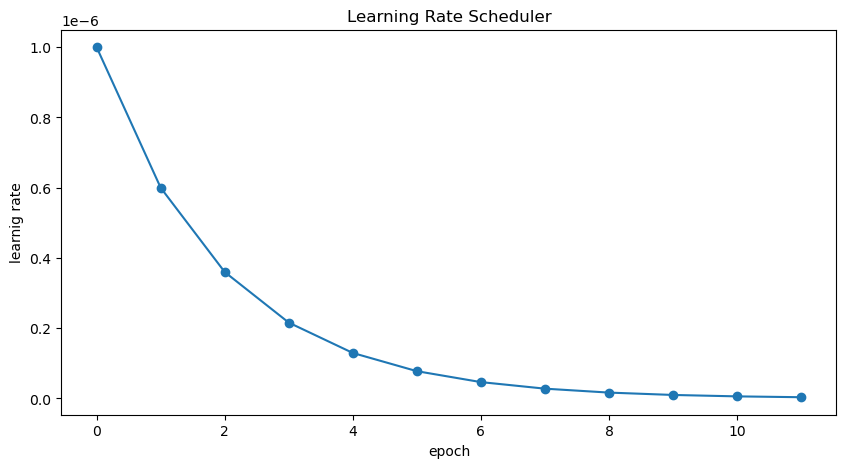

In [9]:
def get_lr_callback(batch_size=8, plot=False):

    initial_lr = 1e-6
   
    def lrfn(epoch):

        lr = initial_lr * 0.60 ** epoch

        return lr
    
    if plot:
        plt.figure(figsize=(10,5))
        plt.plot(np.arange(CFG.epochs), [lrfn(epoch) for epoch in np.arange(CFG.epochs)], marker='o')
        #plt.yscale('log')
        plt.xlabel('epoch'); plt.ylabel('learnig rate')
        plt.title('Learning Rate Scheduler')
        plt.show()

    lr_callback = tf.keras.callbacks.LearningRateScheduler(lrfn, verbose=False)
    return lr_callback

get_lr_callback(CFG.batch_size, plot=True)

In [10]:
os.makedirs('./mobilenetV2_ckpt/liver/', exist_ok=True)

dic_val_losses = {}

for fold in np.arange(CFG.folds):

    train_df = df_liver.query("fold!=@fold")
    valid_df = df_liver.query("fold==@fold")

    train_paths  = train_df.image_path.values
    train_labels = train_df[CFG.target_col].values.astype(np.float32)
    valid_paths  = valid_df.image_path.values
    valid_labels = valid_df[CFG.target_col].values.astype(np.float32)
    #test_paths   = test_df.image_path.values

    K.clear_session()

    model = build_model(CFG.model_name, dim=CFG.img_size)

    train_ds = build_dataset(train_paths, train_labels)
    valid_ds = build_dataset(valid_paths, valid_labels)

    ## save best model after each fold
    save = tf.keras.callbacks.ModelCheckpoint('./mobilenetV2_ckpt/liver/fold-%i.h5'%fold, monitor='val_loss', 
                                              verbose=1, save_best_only=True,
                                              save_weights_only=False, mode='min', save_freq='epoch')
    
    logs='./logs/mobilenetV2/liver/fit/' + datetime.now().strftime('%Y%m%d-%H%M%S')
    tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=logs, update_freq='epoch')
    earlystopping_callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=2, verbose=0, mode='min', baseline=None, restore_best_weights=True)
    
    callbacks_list = []
    callbacks_list.append(save)
    callbacks_list.append(get_lr_callback(CFG.batch_size))
    callbacks_list.append(tensorboard_callback)
    callbacks_list.append(earlystopping_callback)

    history = model.fit(train_ds, validation_data = valid_ds, 
                        epochs=CFG.epochs, steps_per_epoch=None, 
                        callbacks = callbacks_list, max_queue_size=1, verbose=1)
                        
    best_epoch = np.argmin(history.history['val_loss'])
    best_loss = history.history['val_loss'][best_epoch]
    best_acc = history.history['val_accuracy'][best_epoch]

    print(f'FOLD {fold} RESULTS')
    print(f'BEST Loss  : {best_loss:.3f}\nBEST Acc   : {best_acc:.3f}\nBEST Epoch : {best_epoch}')

    dic_val_losses[fold] = best_loss

K.clear_session()
gc.collect()


2024-01-13 12:14:23.950510: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M2
2024-01-13 12:14:23.950532: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 24.00 GB
2024-01-13 12:14:23.950535: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 8.00 GB
2024-01-13 12:14:23.950569: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2024-01-13 12:14:23.950586: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


Number of layers in base: 155
Fine tuning from layer 151
Epoch 1/12


2024-01-13 12:14:28.981639: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:117] Plugin optimizer for device_type GPU is enabled.


37879/37879 [==============================] - ETA: 0s - loss: 0.6399 - accuracy: 0.6292
Epoch 1: val_loss improved from inf to 0.83097, saving model to ./mobilenetV2_ckpt/liver/fold-0.h5
37879/37879 [==============================] - 2291s 60ms/step - loss: 0.6399 - accuracy: 0.6292 - val_loss: 0.8310 - val_accuracy: 0.4649 - lr: 1.0000e-06
Epoch 2/12
37879/37879 [==============================] - ETA: 0s - loss: 0.6293 - accuracy: 0.6406
Epoch 2: val_loss improved from 0.83097 to 0.80816, saving model to ./mobilenetV2_ckpt/liver/fold-0.h5
37879/37879 [==============================] - 2679s 71ms/step - loss: 0.6293 - accuracy: 0.6406 - val_loss: 0.8082 - val_accuracy: 0.4899 - lr: 6.0000e-07
Epoch 3/12
37879/37879 [==============================] - ETA: 0s - loss: 0.6260 - accuracy: 0.6439
Epoch 3: val_loss improved from 0.80816 to 0.78408, saving model to ./mobilenetV2_ckpt/liver/fold-0.h5
37879/37879 [==============================] - 1665s 44ms/step - loss: 0.6260 - accuracy: 0.64

83042

In [9]:
test_df = pd.read_csv('./Dataset/test/test.csv')

In [10]:
CKPT_DIRS = [ (CFG.img_size, './mobilenetV2_ckpt/liver/'),]

MODEL_CONFIGS = []
for img_size, ckpt_dir in  CKPT_DIRS:
    paths = sorted(glob(os.path.join(ckpt_dir, '*h5')))[0:CFG.folds]
    MODEL_CONFIGS.append([img_size, paths])
display(MODEL_CONFIGS)

[[[224, 224],
  ['./mobilenetV2_ckpt/liver/fold-0.h5',
   './mobilenetV2_ckpt/liver/fold-1.h5',
   './mobilenetV2_ckpt/liver/fold-2.h5',
   './mobilenetV2_ckpt/liver/fold-3.h5']]]

In [11]:
def post_proc(pred):
    proc_pred = np.empty(2*1, dtype='float32')

    proc_pred[0] = 1 - pred[0] # liver-healthy
    proc_pred[1] = pred[0] # liver-injured

    return proc_pred


patient_ids = test_df['patient_id'].unique()

patient_ids.sort()

patient_preds = np.zeros(shape=(len(patient_ids), 2), dtype='float32')

preds = np.zeros(shape=(1, 1), dtype=np.float32)

for pidx, patient_id in tqdm(enumerate(patient_ids)):

    patient_df = test_df[test_df['patient_id'] == patient_id]

    test_paths   = patient_df.image_path.values

    test_ds = build_dataset(test_paths, augment=False)

    model_preds = np.zeros(shape=(1, 1), dtype=np.float32)

    print(f'Patient ID: {patient_id}')

    for midx, (img_size, fold_paths) in enumerate(MODEL_CONFIGS):

        patient_images = patient_df.image_path.tolist()

        min_batchsize = len(patient_images)
        CFG.batch_size = min(min_batchsize, CFG.batch_size)

        dtest = build_dataset(patient_images, batch_size=CFG.batch_size, cache=False,
                                   decode_fn=build_decoder(with_labels=False, target_size=CFG.img_size))
        
        for fold_path in fold_paths:

            model = tf.keras.models.load_model(fold_path, compile=False)
    
            pred5 = model.predict(dtest, verbose=1)
            pred4 = np.concatenate(pred5, axis=-1).astype('float32')
            pred3 = pred4[:len(patient_images)]
            pred2 = np.mean(pred3.reshape(1, len(patient_images), 1), axis=0)
            pred = np.max(pred2, axis=0) # taking max prediction of all ct scans for a patient
        
            model_preds += pred / (len(fold_paths))
                            
            del model
            K.clear_session()
            gc.collect()
        
        del dtest, patient_images
        K.clear_session()
        gc.collect()

    patient_preds[pidx, :] += post_proc(pred)

    del model_preds
    K.clear_session()
    gc.collect()


0it [00:00, ?it/s]

2024-01-13 23:58:15.399096: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M2
2024-01-13 23:58:15.399229: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 24.00 GB
2024-01-13 23:58:15.399239: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 8.00 GB
2024-01-13 23:58:15.399573: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2024-01-13 23:58:15.399613: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


Patient ID: 537


2024-01-13 23:58:17.780438: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:117] Plugin optimizer for device_type GPU is enabled.


63/63 [==============================] - 2s 21ms/step


1it [00:15, 15.45s/it]

Patient ID: 902
132/132 [==============================] - 4s 24ms/step


2it [00:38, 19.85s/it]

Patient ID: 908
179/179 [==============================] - 5s 23ms/step


3it [01:07, 23.88s/it]

Patient ID: 1900
168/168 [==============================] - 5s 25ms/step


4it [01:34, 25.37s/it]

Patient ID: 1938
161/161 [==============================] - 5s 25ms/step


5it [02:03, 26.59s/it]

Patient ID: 3308
189/189 [==============================] - 7s 29ms/step


6it [02:41, 30.32s/it]

Patient ID: 4331
249/249 [==============================] - 9s 31ms/step


7it [03:30, 36.64s/it]

Patient ID: 4720
174/174 [==============================] - 7s 30ms/step


8it [04:11, 38.04s/it]

Patient ID: 5273
64/64 [==============================] - 4s 39ms/step


9it [04:37, 34.14s/it]

Patient ID: 5973
39/39 [==============================] - 3s 48ms/step


10it [04:58, 30.30s/it]

Patient ID: 6780
180/180 [==============================] - 9s 39ms/step


11it [05:39, 33.33s/it]

Patient ID: 7188
175/175 [==============================] - 7s 28ms/step


12it [06:17, 34.83s/it]

Patient ID: 8420
96/96 [==============================] - 4s 24ms/step


13it [06:48, 33.60s/it]

Patient ID: 9093
231/231 [==============================] - 8s 25ms/step


14it [07:34, 37.35s/it]

Patient ID: 10127
376/376 [==============================] - 12s 27ms/step


15it [08:47, 48.09s/it]

Patient ID: 12008
66/66 [==============================] - 5s 54ms/step


16it [09:18, 43.12s/it]

Patient ID: 12898
70/70 [==============================] - 5s 48ms/step


17it [09:52, 40.41s/it]

Patient ID: 13769
75/75 [==============================] - 5s 46ms/step


18it [10:26, 38.36s/it]

Patient ID: 14654
62/62 [==============================] - 7s 64ms/step


19it [11:03, 37.84s/it]

Patient ID: 16195
30/30 [==============================] - 4s 59ms/step


20it [11:30, 34.81s/it]

Patient ID: 16198
39/39 [==============================] - 5s 79ms/step


21it [12:05, 34.81s/it]

Patient ID: 16335
66/66 [==============================] - 6s 55ms/step


22it [12:44, 35.90s/it]

Patient ID: 16682
62/62 [==============================] - 7s 60ms/step


23it [13:28, 38.49s/it]

Patient ID: 17178
76/76 [==============================] - 7s 51ms/step


24it [14:14, 40.83s/it]

Patient ID: 17890
40/40 [==============================] - 5s 73ms/step


25it [14:52, 39.83s/it]

Patient ID: 18905
213/213 [==============================] - 14s 52ms/step


26it [15:55, 46.84s/it]

Patient ID: 19448
80/80 [==============================] - 6s 38ms/step


27it [16:41, 46.42s/it]

Patient ID: 19855
71/71 [==============================] - 8s 68ms/step


28it [17:34, 48.66s/it]

Patient ID: 20454
67/67 [==============================] - 5s 36ms/step


29it [18:14, 45.95s/it]

Patient ID: 20689
278/278 [==============================] - 17s 43ms/step


30it [19:41, 58.12s/it]

Patient ID: 20930
138/138 [==============================] - 12s 53ms/step


31it [20:47, 60.72s/it]

Patient ID: 21759
152/152 [==============================] - 11s 39ms/step


32it [22:03, 65.11s/it]

Patient ID: 22099
292/292 [==============================] - 17s 38ms/step


33it [23:36, 73.59s/it]

Patient ID: 23185
449/449 [==============================] - 28s 49ms/step


34it [25:51, 91.99s/it]

Patient ID: 23332
198/198 [==============================] - 17s 56ms/step


35it [27:07, 87.21s/it]

Patient ID: 24329
157/157 [==============================] - 14s 51ms/step


36it [28:15, 81.31s/it]

Patient ID: 24975
190/190 [==============================] - 12s 40ms/step


37it [29:32, 80.13s/it]

Patient ID: 29565
51/51 [==============================] - 7s 54ms/step


38it [30:19, 70.12s/it]

Patient ID: 30628
174/174 [==============================] - 12s 53ms/step


39it [31:34, 71.52s/it]

Patient ID: 31777
41/41 [==============================] - 8s 140ms/step


40it [32:38, 69.46s/it]

Patient ID: 32197
63/63 [==============================] - 8s 51ms/step


41it [33:34, 65.32s/it]

Patient ID: 33029
243/243 [==============================] - 11s 36ms/step


42it [34:51, 68.99s/it]

Patient ID: 33182
253/253 [==============================] - 12s 30ms/step


43it [36:13, 72.76s/it]

Patient ID: 33610
49/49 [==============================] - 8s 50ms/step


44it [37:15, 69.51s/it]

Patient ID: 34354
111/111 [==============================] - 11s 44ms/step


45it [38:36, 73.14s/it]

Patient ID: 34386
29/29 [==============================] - 9s 205ms/step


46it [39:46, 72.10s/it]

Patient ID: 35138
51/51 [==============================] - 8s 51ms/step


47it [40:46, 68.48s/it]

Patient ID: 35574
200/200 [==============================] - 14s 42ms/step


48it [42:12, 73.56s/it]

Patient ID: 35941
184/184 [==============================] - 11s 29ms/step


49it [43:27, 74.02s/it]

Patient ID: 36017
66/66 [==============================] - 13s 107ms/step


50it [44:48, 76.12s/it]

Patient ID: 36686
82/82 [==============================] - 11s 66ms/step


51it [46:12, 78.67s/it]

Patient ID: 37425
139/139 [==============================] - 14s 57ms/step


52it [47:41, 81.78s/it]

Patient ID: 38067
170/170 [==============================] - 13s 58ms/step


53it [49:05, 82.22s/it]

Patient ID: 38088
112/112 [==============================] - 10s 36ms/step


54it [50:18, 79.54s/it]

Patient ID: 38109
59/59 [==============================] - 13s 120ms/step


55it [51:38, 79.77s/it]

Patient ID: 40740
171/171 [==============================] - 13s 39ms/step


56it [53:09, 83.04s/it]

Patient ID: 41392
163/163 [==============================] - 12s 53ms/step


57it [54:28, 81.75s/it]

Patient ID: 41565
28/28 [==============================] - 7s 70ms/step


58it [55:23, 73.90s/it]

Patient ID: 42358
78/78 [==============================] - 12s 89ms/step


59it [56:38, 74.15s/it]

Patient ID: 42915
65/65 [==============================] - 8s 43ms/step


60it [57:42, 71.12s/it]

Patient ID: 44365
142/142 [==============================] - 15s 78ms/step


61it [59:09, 75.93s/it]

Patient ID: 44861
92/92 [==============================] - 11s 39ms/step


62it [1:00:24, 75.46s/it]

Patient ID: 45718
46/46 [==============================] - 16s 188ms/step


63it [1:01:51, 79.15s/it]

Patient ID: 46680
41/41 [==============================] - 13s 229ms/step


64it [1:03:11, 79.36s/it]

Patient ID: 46909
75/75 [==============================] - 15s 133ms/step


65it [1:04:44, 83.50s/it]

Patient ID: 47201
262/262 [==============================] - 15s 39ms/step


66it [1:06:30, 90.17s/it]

Patient ID: 47486
24/24 [==============================] - 10s 103ms/step


67it [1:07:42, 84.83s/it]

Patient ID: 47975
227/227 [==============================] - 18s 44ms/step


68it [1:09:37, 93.79s/it]

Patient ID: 48128
28/28 [==============================] - 14s 205ms/step


69it [1:11:04, 91.62s/it]

Patient ID: 48330
59/59 [==============================] - 12s 60ms/step


70it [1:12:25, 88.42s/it]

Patient ID: 48514
194/194 [==============================] - 15s 54ms/step


71it [1:14:13, 94.40s/it]

Patient ID: 48684
29/29 [==============================] - 11s 106ms/step


72it [1:15:31, 89.50s/it]

Patient ID: 48793
159/159 [==============================] - 14s 36ms/step


73it [1:17:04, 90.43s/it]

Patient ID: 49044
29/29 [==============================] - 15s 366ms/step


74it [1:18:39, 91.89s/it]

Patient ID: 49255
46/46 [==============================] - 15s 147ms/step


75it [1:20:19, 94.41s/it]

Patient ID: 49505
155/155 [==============================] - 21s 79ms/step


76it [1:22:11, 99.69s/it]

Patient ID: 50219
259/259 [==============================] - 20s 43ms/step


77it [1:24:02, 103.15s/it]

Patient ID: 50833
154/154 [==============================] - 19s 85ms/step


78it [1:25:56, 106.28s/it]

Patient ID: 54828
42/42 [==============================] - 16s 169ms/step


79it [1:27:40, 105.69s/it]

Patient ID: 56050
311/311 [==============================] - 19s 41ms/step


80it [1:29:47, 111.94s/it]

Patient ID: 57055
187/187 [==============================] - 22s 66ms/step


81it [1:31:46, 114.16s/it]

Patient ID: 58547
168/168 [==============================] - 16s 36ms/step


82it [1:33:27, 110.09s/it]

Patient ID: 59270
100/100 [==============================] - 18s 91ms/step


83it [1:35:21, 111.26s/it]

Patient ID: 59737
25/25 [==============================] - 19s 414ms/step


84it [1:37:15, 112.07s/it]

Patient ID: 59982
229/229 [==============================] - 23s 60ms/step


85it [1:39:29, 118.65s/it]

Patient ID: 60009
191/191 [==============================] - 21s 65ms/step


86it [1:41:41, 122.74s/it]

Patient ID: 60515
69/69 [==============================] - 14s 78ms/step


87it [1:43:32, 119.16s/it]

Patient ID: 60836
200/200 [==============================] - 24s 76ms/step


88it [1:46:05, 129.25s/it]

Patient ID: 62095
26/26 [==============================] - 19s 348ms/step


89it [1:48:17, 130.07s/it]

Patient ID: 62118
168/168 [==============================] - 18s 44ms/step


90it [1:50:20, 127.97s/it]

Patient ID: 62705
163/163 [==============================] - 10s 41ms/step


91it [1:52:18, 125.17s/it]

Patient ID: 62845
116/116 [==============================] - 18s 67ms/step


92it [1:54:18, 123.50s/it]

Patient ID: 63325
41/41 [==============================] - 7s 105ms/step


93it [1:55:59, 116.62s/it]

Patient ID: 63338
178/178 [==============================] - 16s 31ms/step


94it [1:57:54, 116.19s/it]

Patient ID: 64428
74/74 [==============================] - 15s 53ms/step


95it [1:59:51, 116.49s/it]

Patient ID: 64573
174/174 [==============================] - 15s 34ms/step


96it [2:01:46, 115.93s/it]

Patient ID: 65083
59/59 [==============================] - 15s 142ms/step


97it [2:03:50, 118.37s/it]

Patient ID: 65360
35/35 [==============================] - 18s 253ms/step


98it [2:05:59, 121.70s/it]

Patient ID: 65415
30/30 [==============================] - 14s 357ms/step


99it [2:08:10, 124.42s/it]

Patient ID: 65456
62/62 [==============================] - 20s 162ms/step


100it [2:10:16, 78.16s/it] 


In [11]:
answer_df = pd.read_csv('./Dataset/test/answer.csv')

In [13]:
pred_liver = pd.DataFrame({'patient_id':patient_ids,})

for i, row in enumerate(patient_preds):
    pred_liver.loc[i, 'liver_healthy'] = row[0]
    pred_liver.loc[i, 'liver_injury'] = row[1]

pred_df = pred_liver.sort_values('patient_id')

Liver thresholds:
[       inf 0.94393182 0.93885946 0.93633068 0.93036622 0.92186266
 0.91845495 0.91561288 0.90936536 0.90736878 0.90481067 0.90024847
 0.89979541 0.89887702 0.89723569 0.89461136 0.89376199 0.89309543
 0.89151275 0.89064586 0.88909453 0.88113046 0.87505984 0.87101972
 0.86872965 0.86739516 0.85566837 0.84969491 0.8494404  0.84866345
 0.84650266 0.84402931 0.84118092 0.83671111 0.83461452 0.83371586
 0.83360291 0.8218056  0.81683153 0.81061643 0.80999392 0.80930519
 0.80714917 0.80685925 0.80276066 0.80215144 0.79772627 0.79290241
 0.78893596 0.78828877 0.78827786 0.78810406 0.78768504 0.78385454
 0.78041321 0.77941138 0.77846038 0.77740884 0.7747131  0.77290511
 0.77063608 0.7698735  0.76606619 0.76509655 0.7619077  0.75520998
 0.7513507  0.747262   0.74657887 0.74446088 0.74389976 0.74044687
 0.74020809 0.73832262 0.73679912 0.73197198 0.72965109 0.71975899
 0.71505916 0.71376407 0.71340817 0.7125448  0.71033007 0.69838822
 0.68625408 0.68550336 0.67211175 0.66441333

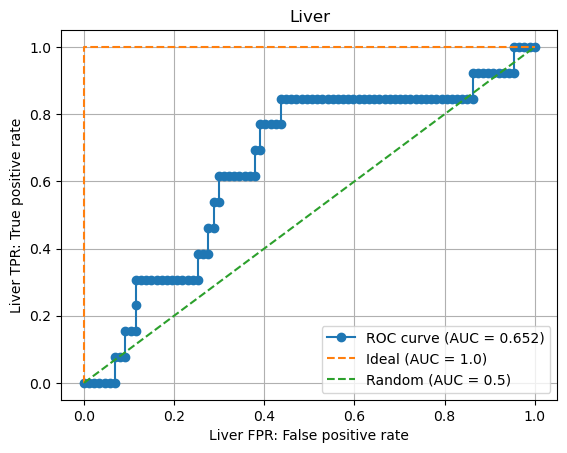

In [14]:
liver_pred = pred_liver['liver_injury'].to_list()
liver_ans = answer_df['liver_injury'].to_list()
liver_roc = roc(liver_ans, liver_pred, drop_intermediate=False)
liver_roc_fpr, liver_roc_tpr, liver_roc_thresholds = liver_roc

plt.plot(liver_roc_fpr, liver_roc_tpr, marker='o', label='ROC curve (AUC = %0.3f)' % auroc(liver_ans, liver_pred))
plt.plot([0,0,1], [0,1,1], linestyle='--', label='Ideal (AUC = 1.0)')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random (AUC = 0.5)')
plt.xlabel('Liver FPR: False positive rate')
plt.ylabel('Liver TPR: True positive rate')
plt.legend()
plt.title('Liver')
plt.grid()
plt.show

print(f'Liver thresholds:\n{liver_roc_thresholds}')

Liver thresholds:
[0.50250739 0.56300521 0.60287213 0.60864168 0.60998988 0.62608039
 0.63286155 0.65550953 0.65838736 0.65848804 0.6586929  0.66129333
 0.66279644 0.66441333 0.67211175 0.68550336 0.68625408 0.69838822
 0.71033007 0.7125448  0.71340817 0.71376407 0.71505916 0.71975899
 0.72965109 0.73197198 0.73679912 0.73832262 0.74020809 0.74044687
 0.74389976 0.74446088 0.74657887 0.747262   0.7513507  0.75520998
 0.7619077  0.76509655 0.76606619 0.7698735  0.77063608 0.77290511
 0.7747131  0.77740884 0.77846038 0.77941138 0.78041321 0.78385454
 0.78768504 0.78810406 0.78827786 0.78828877 0.78893596 0.79290241
 0.79772627 0.80215144 0.80276066 0.80685925 0.80714917 0.80930519
 0.80999392 0.81061643 0.81683153 0.8218056  0.83360291 0.83371586
 0.83461452 0.83671111 0.84118092 0.84402931 0.84650266 0.84866345
 0.8494404  0.84969491 0.85566837 0.86739516 0.86872965 0.87101972
 0.87505984 0.88113046 0.88909453 0.89064586 0.89151275 0.89309543
 0.89376199 0.89461136 0.89723569 0.89887702

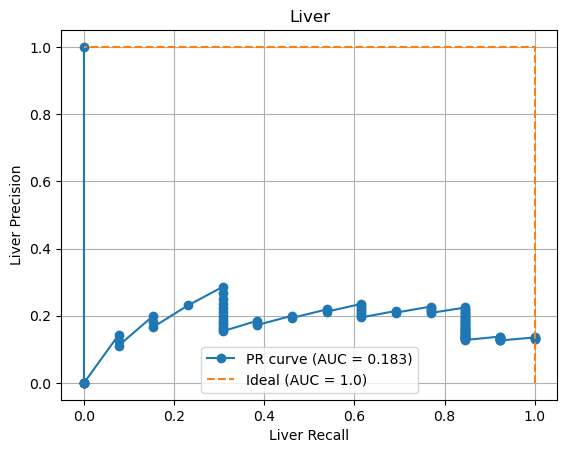

In [15]:
liver_prc = prc(liver_ans, liver_pred, drop_intermediate=False)
liver_prc_precision, liver_prc_recall, liver_prc_thresholds = liver_prc

plt.plot(liver_prc_recall, liver_prc_precision, marker='o', label='PR curve (AUC = %0.3f)' % auc(liver_prc_recall, liver_prc_precision))
plt.plot([1,1,0], [0,1,1], linestyle='--', label='Ideal (AUC = 1.0)')
plt.xlabel('Liver Recall')
plt.ylabel('Liver Precision')
plt.legend()
plt.title('Liver')
plt.grid()
plt.show

print(f'Liver thresholds:\n{liver_prc_thresholds}')

In [16]:
def to_one_hot(feature, thresholds):

    organ = feature.split('_')[0]
    pred_df = f'pred_{organ}'
    name1 = f'prediction_{feature}'
    globals()[name1] = globals()[pred_df][feature].to_list()
    name3 = f'one_hot_{feature}'
    globals()[name3] = {}

    for t in thresholds:
        name2 = f'one_hot_{feature}_{str(t)}'
        globals()[name2] = globals()[name1].copy()

        for i, v in enumerate(globals()[name2]):
            if t == float('inf'):
                globals()[name2][i] = 0
            elif v >= t:
                globals()[name2][i] = 1
            elif v < t:
                globals()[name2][i] = 0
        
        globals()[name3][t] = globals()[name2]

    return globals()[name3]

In [17]:
one_hot_liver_injury = to_one_hot('liver_injury', liver_roc_thresholds)


l_liver = []

for key, value in one_hot_liver_injury.items():

    if recall(liver_ans, value) == 1.0:
        l_liver.append(key)

best_threshold_liver = max(l_liver)


print('TN FP\nFN TP')

print('\n')

print('Liver confusion matrix:')
print(cm(liver_ans, one_hot_liver_injury[best_threshold_liver]))
print(f'Liver accuracy: {accuracy(liver_ans, one_hot_liver_injury[best_threshold_liver])}')

TN FP
FN TP


Liver confusion matrix:
[[ 4 83]
 [ 0 13]]
Liver accuracy: 0.17


layer 139, lr 1e-6, 0.60: AUC:0.50, ACC:0.23<br>
layer 143, lr 1e-6, 0.60: AUC:0.53, ACC:0.16<br>
layer 151, lr 1e-6, 0.60: AUC:0.65, ACC:0.17<br>

In [12]:
answer_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype
---  ------                 --------------  -----
 0   Unnamed: 0             100 non-null    int64
 1   patient_id             100 non-null    int64
 2   bowel_healthy          100 non-null    int64
 3   bowel_injury           100 non-null    int64
 4   extravasation_healthy  100 non-null    int64
 5   extravasation_injury   100 non-null    int64
 6   kidney_healthy         100 non-null    int64
 7   kidney_injury          100 non-null    int64
 8   liver_healthy          100 non-null    int64
 9   liver_injury           100 non-null    int64
 10  spleen_healthy         100 non-null    int64
 11  spleen_injury          100 non-null    int64
dtypes: int64(12)
memory usage: 9.5 KB


In [40]:
answer_df[answer_df['liver_injury'] == 1]['patient_id'].unique()

array([ 1900,  5973, 16682, 19448, 29565, 34354, 49255, 54828, 57055,
       60836, 62705, 62845, 65083])

In [41]:
test_df[test_df['patient_id'] == 1900].info()

<class 'pandas.core.frame.DataFrame'>
Index: 669 entries, 1491 to 2159
Data columns (total 19 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   patient_id             669 non-null    int64  
 1   bowel_healthy          669 non-null    int64  
 2   bowel_injury           669 non-null    int64  
 3   extravasation_healthy  669 non-null    int64  
 4   extravasation_injury   669 non-null    int64  
 5   kidney_healthy         669 non-null    int64  
 6   liver_healthy          669 non-null    int64  
 7   spleen_healthy         669 non-null    int64  
 8   any_injury             669 non-null    int64  
 9   series_id              669 non-null    int64  
 10  aortic_hu              669 non-null    float64
 11  incomplete_organ       669 non-null    int64  
 12  instance_number        669 non-null    int64  
 13  image_path             669 non-null    object 
 14  kidney_injury          669 non-null    int64  
 15  liver_i

In [42]:
patient_df = test_df[test_df['patient_id'] == 1900]

paths = patient_df.image_path.values

fig = plt.figure(figsize=(20,600))
fig.set_facecolor('black')
#fig.suptitle('Vanila', fontsize=24, y=0.92)

for i, value in enumerate(paths):
    plt.subplot(150, 5, i+1)
    img = cv2.imread(value, cv2.IMREAD_UNCHANGED)
    name = (value.split('/'))[-1]
    plt.imshow(img, cmap='gray')
    plt.title(f'{name}', fontdict={'color':'white'})
    plt.xticks([])
    plt.yticks([])

plt.show()

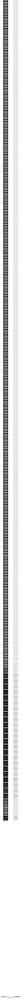

In [43]:
from tensorflow.python.ops.numpy_ops import np_config
np_config.enable_numpy_behavior()

model = tf.keras.models.load_model('./mobilenetV2_ckpt/liver/fold-0.h5', compile=False)

patient_paths  = patient_df.image_path.values
patient_labels = patient_df[CFG.target_col].values

patient_ds = build_dataset(patient_paths, patient_labels, cache=False, batch_size=32, repeat=False, shuffle=1, augment=False)

patient_ds = patient_ds.unbatch().batch(669)

patient_batch = next(iter(patient_ds))

images, targets = patient_batch

pixel_values = images[142:292].numpy()

explainer = shap.GradientExplainer(model, pixel_values)

shap_values = explainer(K.eval(images[142:292]))

shap_values = np.array(shap_values.values).squeeze(axis=0)

shap.image_plot(shap_values, pixel_values, hspace=0.1)